Task 3: Model Evaluation on Superstore Flyers

Apply the trained model to real Canadian Superstore flyers. Detect and classify instances of vegetables or fruits in the flyer images.
Evaluate the model's performance in terms of precision, recall, and mean Average Precision (mAP). Discuss the results and potential areas for improvement.

Task 4: Multi-Class Detection and Probability Scores

Modify the model to enable multi-class detection, allowing the model to detect multiple vegetables or fruits within a single flyer image.
Implement a mechanism to provide probability scores for each detected class. Discuss the approach used to calculate these scores.

Task 5: Reporting and Documentation

Document your approach, including the model architecture, training process, and modifications for multi-class detection and probability scores.
Present visualizations of the model's performance, including bounding box detection and class probabilities on Superstore flyers.

Share insights gained from the project, challenges faced, and potential enhancements to the object detection model.

In [4]:
import os
print("Current working directory:", os.getcwd())

Current working directory: /content


### **Task3 : Test on Flyer**

In this section we will be using the model to predict the flyer using a single class.

As the number of vegetables and fruits are limited and I could not find other flyers in the website, I will be selecting two items.

The first item is tomato which exists in the flyer.
The second item I will test is spinach which does not exist in the flyer.

For this model, we will be testing it with a confidence score threshold of 0.3 for the preprocessing, therefore any bounding boxes with lower than that will not be processed.

We will then only visualise the output of the images with bounding boxes of confidence score above 0.4 and those with IoU (Intersection over Union) above 0.4.

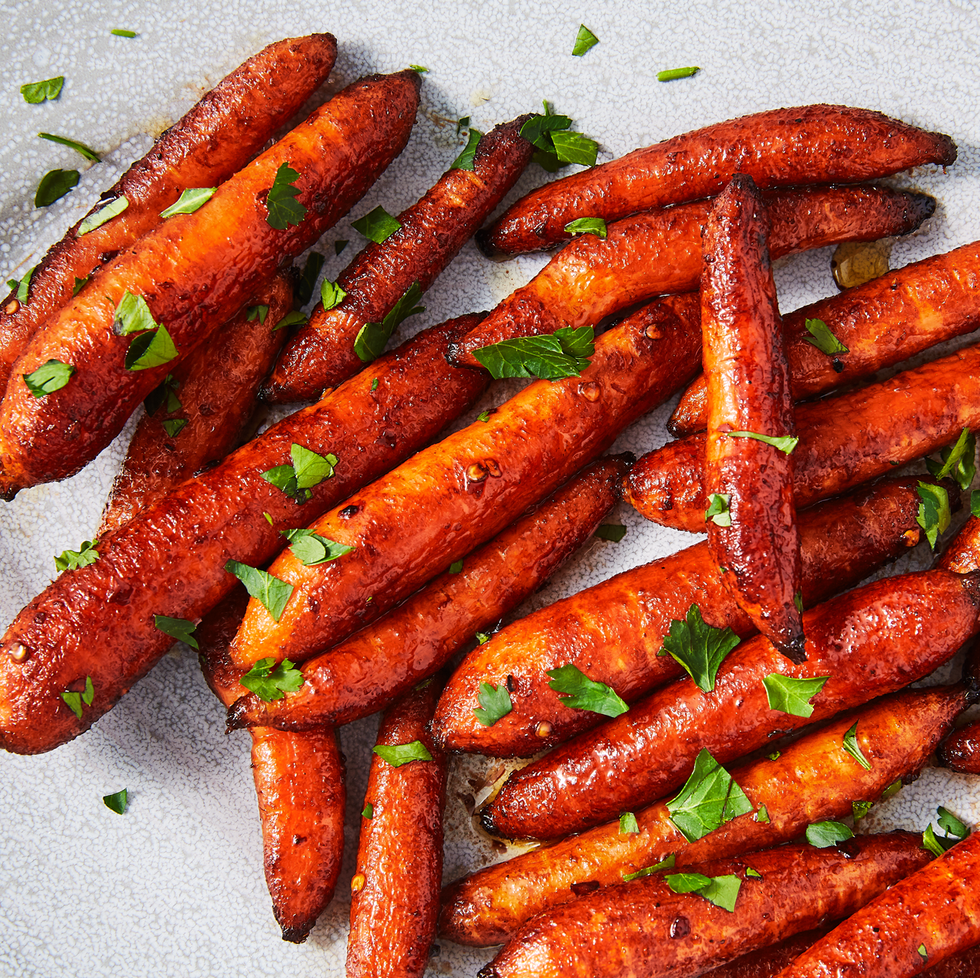

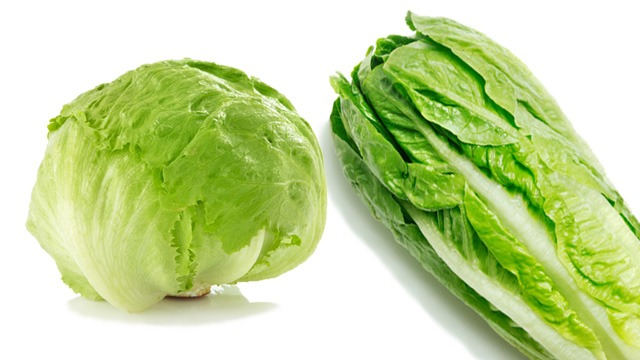

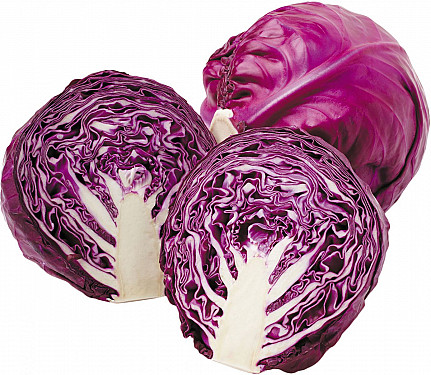

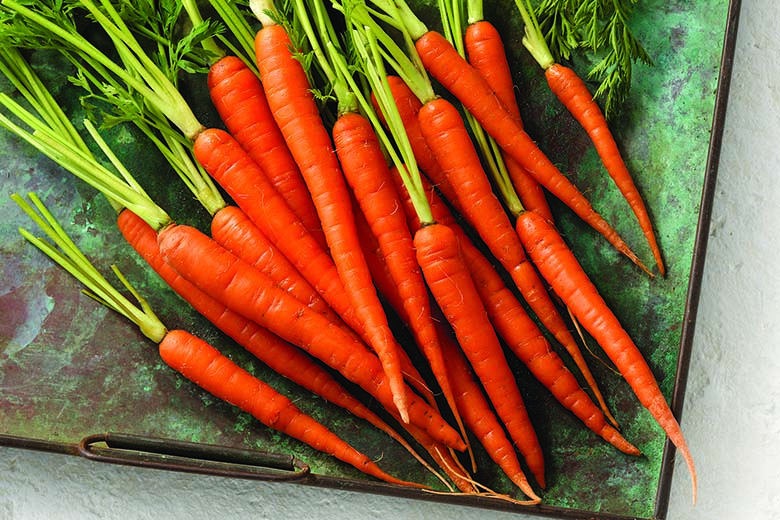

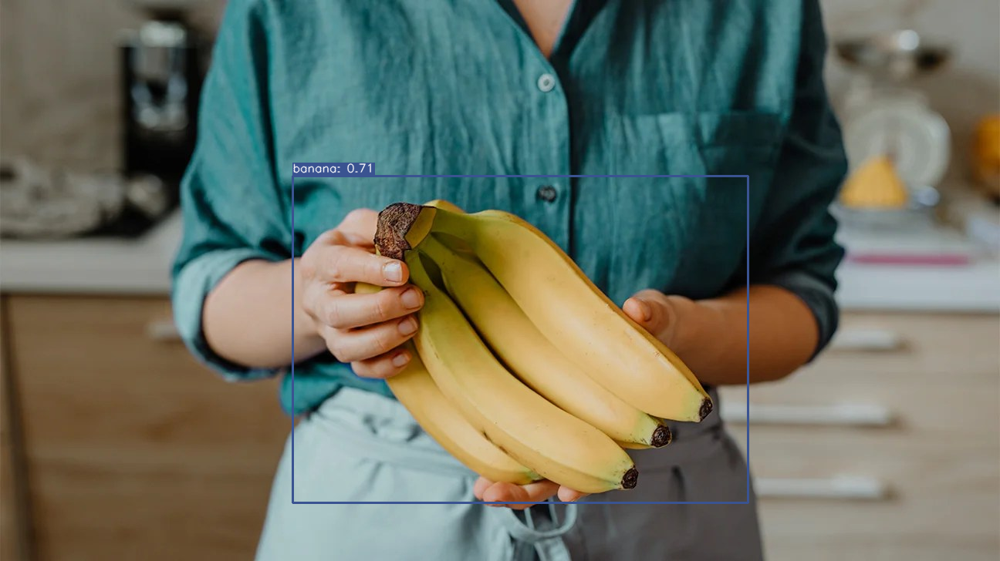

In [16]:
import cv2
import numpy as np
import glob
import random
from google.colab.patches import cv2_imshow

net = cv2.dnn.readNet('yolov3_training_last.weights', 'yolov3_testing.cfg')

# Set the image path from desktop
images_path = glob.glob(r"/content/images_test/*.jpg")
# Reiterate the classes
class_mapping = {
    'banana': 0,
    'cabbage': 1,
    'carrot': 2,
    'lettuce': 3,
    'onion': 4,
    'orange': 5,
    'potato': 6,
    'spinach': 7,
    'strawberry': 8,
    'tomato': 9
}

# Create a list of classes in the same order as class_mapping
classes = list(class_mapping.keys())
class_id = class_mapping['banana']
colors = np.random.uniform(0, 255, size=(len(classes), 3))
class_color = colors[class_id]

layer_names = net.getLayerNames()
output_layers = [layer_names[i - 1] for i in net.getUnconnectedOutLayers()]
colors = np.random.uniform(0, 255, size=(len(classes), 3))


# loop through all the images
for img_path in images_path:
    # Loading image
    img = cv2.imread(img_path)
    height, width, channels = img.shape

    # Detecting objects
    blob = cv2.dnn.blobFromImage(img, 0.00392, (416, 416), (0, 0, 0), True, crop=False)

    net.setInput(blob)
    outs = net.forward(output_layers)

    # Showing informations on the screen
    class_ids = []
    confidences = []
    boxes = []
    for out in outs:
        for detection in out:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            if confidence > 0.3:
                center_x = int(detection[0] * width)
                center_y = int(detection[1] * height)
                w = int(detection[2] * width) if detection[2] * width <= width else width
                h = int(detection[3] * height) if detection[3] * height <= height else height

                x = int(center_x - w / 2)
                y = int(center_y - h / 2)
                boxes.append([x, y, w, h])
                confidences.append(float(confidence))
                class_ids.append(class_id)

    indexes = cv2.dnn.NMSBoxes(boxes, confidences, 0.4, 0.4)

    # Loop through detected objects and draw bounding boxes
    for i in range(len(boxes)):
        if i in indexes:
            x, y, w, h = boxes[i]

            # Make sure only banana class is considered
            if class_ids[i] == class_id:
                label = str(classes[class_id])
                confidence = confidences[i]

                # Draw bounding box
                cv2.rectangle(img, (x, y), (x + w, y + h), class_color, 2)

                # Draw label and confidence score
                text = f"{label}: {confidence:.2f}"
                text_width, text_height = cv2.getTextSize(text, cv2.FONT_HERSHEY_SIMPLEX, 0.5, 1)[0]
                cv2.rectangle(img, (x, y - text_height - 5), (x + text_width, y), class_color, -1)
                cv2.putText(img, text, (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 1, cv2.LINE_AA)

    # Display the image with bounding boxes and confidence scores
    cv2_imshow(img)
    cv2.waitKey(0)
    cv2.destroyAllWindows()


The model works pretty well in identifying banana as an object. We can also see that the confidence score is pretty high at 0.71.

Therefore, we can will continue our model using the same hyperparameter tuning but to identify the flyer image. However, since we know that lettuce is definitely in the picture, we will try with lettuce as the class.

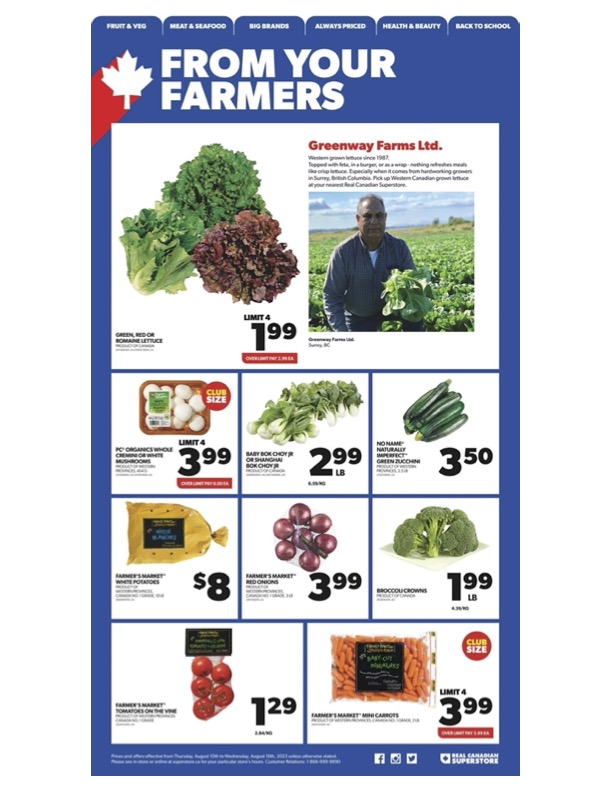

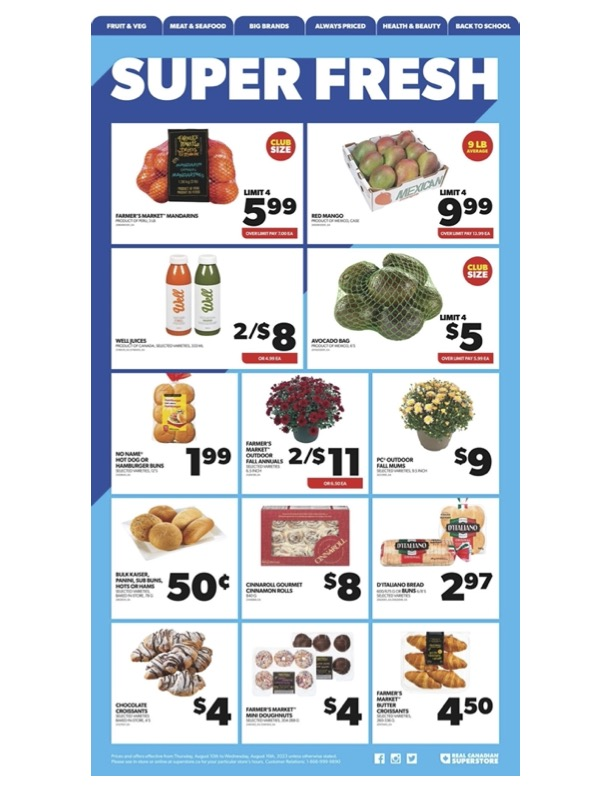

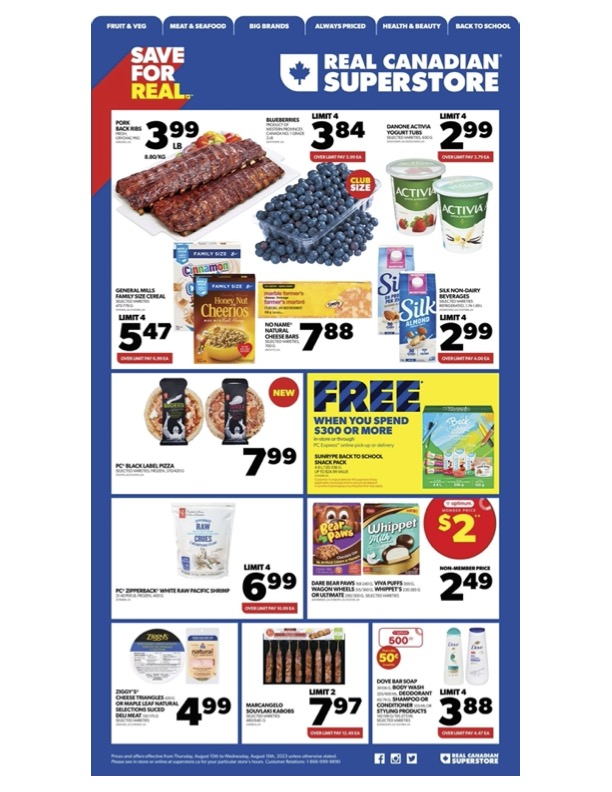

In [24]:
import cv2
import numpy as np
import glob
import random
from google.colab.patches import cv2_imshow

net = cv2.dnn.readNet('yolov3_training_last.weights', 'yolov3_testing.cfg')

# Set the image path from desktop
images_path = glob.glob(r"/content/testing_flyers/*.jpg")

# Reiterate the classes
class_mapping = {
    'banana': 0,
    'cabbage': 1,
    'carrot': 2,
    'lettuce': 3,
    'onion': 4,
    'orange': 5,
    'potato': 6,
    'spinach': 7,
    'strawberry': 8,
    'tomato': 9
}

# Create a list of classes in the same order as class_mapping
classes = list(class_mapping.keys())

# Set the desired class for detection
desired_class = 'lettuce'
class_id = class_mapping[desired_class]
colors = np.random.uniform(0, 255, size=(len(classes), 3))
class_color = colors[class_id]

layer_names = net.getLayerNames()
output_layers = [layer_names[i - 1] for i in net.getUnconnectedOutLayers()]
colors = np.random.uniform(0, 255, size=(len(classes), 3))

# loop through all the images
for img_path in images_path:
    # Loading image
    img = cv2.imread(img_path)
    height, width, channels = img.shape

    # Detecting objects
    blob = cv2.dnn.blobFromImage(img, 0.00392, (416, 416), (0, 0, 0), True, crop=False)

    net.setInput(blob)
    outs = net.forward(output_layers)

    # Showing informations on the screen
    class_ids = []
    confidences = []
    boxes = []
    for out in outs:
        for detection in out:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            if confidence > 0.3:
                center_x = int(detection[0] * width)
                center_y = int(detection[1] * height)
                w = int(detection[2] * width) if detection[2] * width <= width else width
                h = int(detection[3] * height) if detection[3] * height <= height else height

                x = int(center_x - w / 2)
                y = int(center_y - h / 2)
                boxes.append([x, y, w, h])
                confidences.append(float(confidence))
                class_ids.append(class_id)

    indexes = cv2.dnn.NMSBoxes(boxes, confidences, 0.4, 0.4)

    # Loop through detected objects and draw bounding boxes
    for i in range(len(boxes)):
      if i in indexes and class_ids[i] == class_id:
            x, y, w, h = boxes[i]

            # Draw bounding box
            cv2.rectangle(img, (x, y), (x + w, y + h), class_color, 2)

            # Draw label and confidence score
            label = desired_class
            confidence = confidences[i]
            text = f"{label}: {confidence:.2f}"
            text_width, text_height = cv2.getTextSize(text, cv2.FONT_HERSHEY_SIMPLEX, 0.5, 1)[0]
            cv2.rectangle(img, (x, y - text_height - 5), (x + text_width, y), class_color, -1)
            cv2.putText(img, text, (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 1, cv2.LINE_AA)

    # Display the image with bounding boxes and confidence scores
    cv2_imshow(img)
    cv2.waitKey(0)
    cv2.destroyAllWindows()


The model was unable to predict correct image in the flyer hence there are no bounding box. We will try again with a lower confidence score of 0.3 for the outcome while maintaining similar NMS threshold.

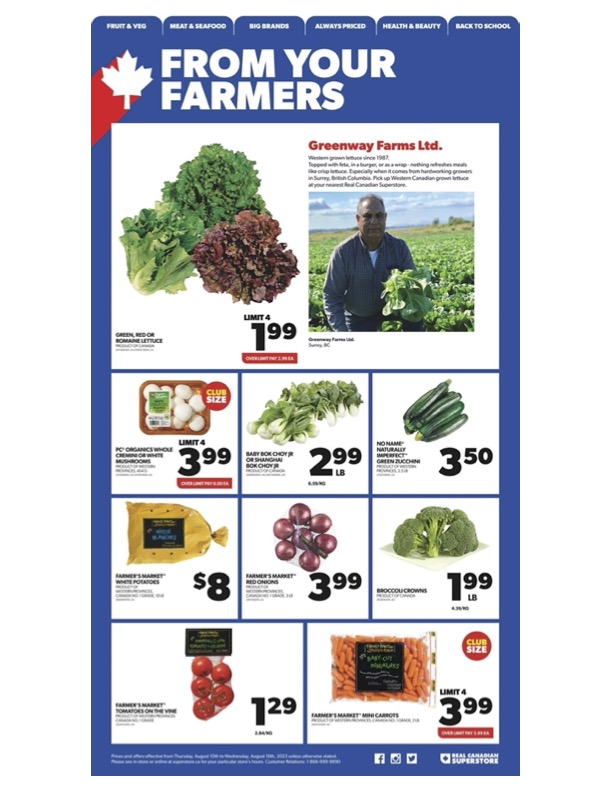

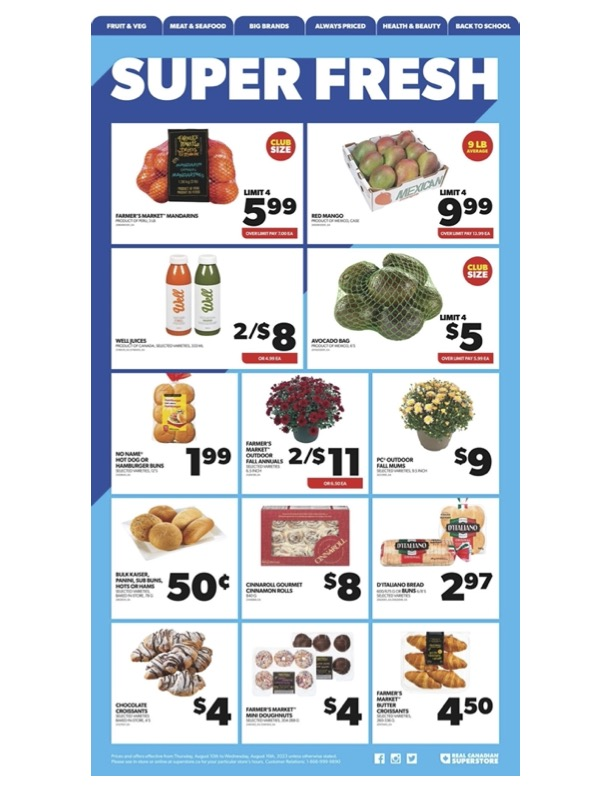

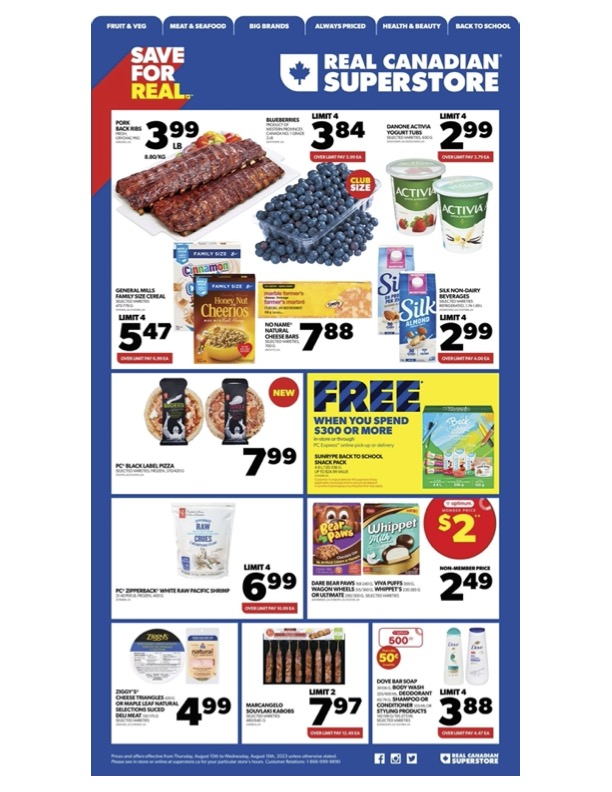

In [25]:
import cv2
import numpy as np
import glob
import random
from google.colab.patches import cv2_imshow

net = cv2.dnn.readNet('yolov3_training_last.weights', 'yolov3_testing.cfg')

# Set the image path from desktop
images_path = glob.glob(r"/content/testing_flyers/*.jpg")

# Reiterate the classes
class_mapping = {
    'banana': 0,
    'cabbage': 1,
    'carrot': 2,
    'lettuce': 3,
    'onion': 4,
    'orange': 5,
    'potato': 6,
    'spinach': 7,
    'strawberry': 8,
    'tomato': 9
}

# Create a list of classes in the same order as class_mapping
classes = list(class_mapping.keys())

# Set the desired class for detection
desired_class = 'lettuce'
class_id = class_mapping[desired_class]
colors = np.random.uniform(0, 255, size=(len(classes), 3))
class_color = colors[class_id]

layer_names = net.getLayerNames()
output_layers = [layer_names[i - 1] for i in net.getUnconnectedOutLayers()]
colors = np.random.uniform(0, 255, size=(len(classes), 3))

# loop through all the images
for img_path in images_path:
    # Loading image
    img = cv2.imread(img_path)
    height, width, channels = img.shape

    # Detecting objects
    blob = cv2.dnn.blobFromImage(img, 0.00392, (416, 416), (0, 0, 0), True, crop=False)

    net.setInput(blob)
    outs = net.forward(output_layers)

    # Showing informations on the screen
    class_ids = []
    confidences = []
    boxes = []
    for out in outs:
        for detection in out:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            if confidence > 0.3:
                center_x = int(detection[0] * width)
                center_y = int(detection[1] * height)
                w = int(detection[2] * width) if detection[2] * width <= width else width
                h = int(detection[3] * height) if detection[3] * height <= height else height

                x = int(center_x - w / 2)
                y = int(center_y - h / 2)
                boxes.append([x, y, w, h])
                confidences.append(float(confidence))
                class_ids.append(class_id)

    indexes = cv2.dnn.NMSBoxes(boxes, confidences, 0.3, 0.4)

    # Loop through detected objects and draw bounding boxes
    for i in range(len(boxes)):
      if i in indexes and class_ids[i] == class_id:
            x, y, w, h = boxes[i]

            # Draw bounding box
            cv2.rectangle(img, (x, y), (x + w, y + h), class_color, 2)

            # Draw label and confidence score
            label = desired_class
            confidence = confidences[i]
            text = f"{label}: {confidence:.2f}"
            text_width, text_height = cv2.getTextSize(text, cv2.FONT_HERSHEY_SIMPLEX, 0.5, 1)[0]
            cv2.rectangle(img, (x, y - text_height - 5), (x + text_width, y), class_color, -1)
            cv2.putText(img, text, (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 1, cv2.LINE_AA)

    # Display the image with bounding boxes and confidence scores
    cv2_imshow(img)
    cv2.waitKey(0)
    cv2.destroyAllWindows()

The model perform very poorly as seen by the lack of prediction shown above. Both items tested are supposed to be in the flyer but it was undetected. It seems that the model is unable to predict well due to the lack of training inputs.

#### **Evaluation**

TO evaluate the model's performance, it is important to look at statistical terms of precision, recall, and mean Average Precision (mAP).

For the precision and recall, it depends on several metrics:

* True Positive (TP) : is when the prediction managed to predict the ground truth
* True Negative (TN) : is infinite because it is when the prediction did not predict the ground truth and there could be so many bounding boxes
* False Positive (FP) : is when the prediction missed the ground truth and detected something else
* False Negative (FN) : is when the ground truth is undetected

Therefore, in other words:
* Precision is TP / all predictions
* Recall is TP/ all ground truth

Usually in a classification model we ware able to use confusion matrix and classification report, however, image detection is a tad different. Therefore, we will be relying on darknet to gauge the model.

In [26]:
import os

current_directory = os.getcwd()
print("Current Working Directory:", current_directory)

Current Working Directory: /content


We will be using darknet to calculate the evaluations

In [27]:
# CLone darknet
!git clone https://github.com/AlexeyAB/darknet

Cloning into 'darknet'...
remote: Enumerating objects: 15549, done.
remote: Counting objects: 100% (35/35), done.
remote: Compressing objects: 100% (29/29), done.
remote: Total 15549 (delta 10), reused 27 (delta 6), pack-reused 15514
Receiving objects: 100% (15549/15549), 14.25 MiB | 20.26 MiB/s, done.
Resolving deltas: 100% (10422/10422), done.


In [34]:
# Compile
%cd darknet
!sed -i 's/OPENCV=0/OPENCV=1/' Makefile
!sed -i 's/GPU=0/GPU=1/' Makefile
!sed -i 's/CUDNN=0/CUDNN=1/' Makefile
!make

/content/darknet
mkdir -p ./obj/
mkdir -p backup
chmod +x *.sh
g++ -std=c++11 -std=c++11 -Iinclude/ -I3rdparty/stb/include -DOPENCV `pkg-config --cflags opencv4 2> /dev/null || pkg-config --cflags opencv` -DGPU -I/usr/local/cuda/include/ -DCUDNN -Wall -Wfatal-errors -Wno-unused-result -Wno-unknown-pragmas -fPIC -rdynamic -Ofast -DOPENCV -DGPU -DCUDNN -I/usr/local/cudnn/include -c ./src/image_opencv.cpp -o obj/image_opencv.o
./src/image_opencv.cpp: In function ‘void draw_detections_cv_v3(void**, detection*, int, float, char**, image**, int, int)’:
./src/image_opencv.cpp:946:23: warning: variable ‘rgb’ set but not used []8;;https://gcc.gnu.org/onlinedocs/gcc/Warning-Options.html#index-Wunused-but-set-variable-Wunused-but-set-variable]8;;]
  946 |                 float rgb[3];
      |                       ^~~
./src/image_opencv.cpp: In function ‘void draw_train_loss(char*, void**, int, float, float, int, int, float, int, char*, float, int, int, double)’:
./src/image_opencv.cpp:1147:1

In [49]:
!echo -e 'carrot\ncabbage\ntomato\nspinach\nbanana\norange\nlettuce\nonion\nstrawberry\npotato' > data/obj.names
!echo -e 'classes= 10\ntrain  = data/train.txt\nvalid  = data/test.txt\nnames = data/obj.names\nbackup = /mydrive/Yolov3' > data/obj.data

In [55]:
# Extract images
!mkdir -p /content/data/obj
!unzip /content/images.zip -d /content/data/obj

Archive:  /content/images.zip
   creating: /content/data/obj/images/
  inflating: /content/data/obj/__MACOSX/._images  
  inflating: /content/data/obj/images/cabbage_14.jpg  
  inflating: /content/data/obj/__MACOSX/images/._cabbage_14.jpg  
  inflating: /content/data/obj/images/spinach_10.xml.txt  
  inflating: /content/data/obj/images/potato_7.xml.txt  
  inflating: /content/data/obj/images/potato_9.jpg  
  inflating: /content/data/obj/__MACOSX/images/._potato_9.jpg  
  inflating: /content/data/obj/images/tomato_13.xml.txt  
  inflating: /content/data/obj/images/carrot_27.xml.txt  
  inflating: /content/data/obj/images/tomato_5.xml.txt  
  inflating: /content/data/obj/images/onion_9.jpg  
  inflating: /content/data/obj/__MACOSX/images/._onion_9.jpg  
  inflating: /content/data/obj/images/tomato_15.jpg  
  inflating: /content/data/obj/__MACOSX/images/._tomato_15.jpg  
  inflating: /content/data/obj/images/potato_8.jpg  
  inflating: /content/data/obj/__MACOSX/images/._potato_8.jpg  
  

In [57]:
import glob
images_list = glob.glob("/content/data/obj/images/*.jpg")
print(images_list)

['/content/data/obj/images/potato_7.jpg', '/content/data/obj/images/strawberry_18.jpg', '/content/data/obj/images/orange_8.jpg', '/content/data/obj/images/strawberry_13.jpg', '/content/data/obj/images/lettuce_12.jpg', '/content/data/obj/images/spinach_13.jpg', '/content/data/obj/images/strawberry_15.jpg', '/content/data/obj/images/spinach_10.jpg', '/content/data/obj/images/banana_15.jpg', '/content/data/obj/images/cabbage_12.jpg', '/content/data/obj/images/lettuce_9.jpg', '/content/data/obj/images/potato_11.jpg', '/content/data/obj/images/carrot_13.jpg', '/content/data/obj/images/tomato_6.jpg', '/content/data/obj/images/lettuce_4.jpg', '/content/data/obj/images/orange_9.jpg', '/content/data/obj/images/lettuce_8.jpg', '/content/data/obj/images/onion_18.jpg', '/content/data/obj/images/cabbage_17.jpg', '/content/data/obj/images/strawberry_7.jpg', '/content/data/obj/images/orange_20.jpg', '/content/data/obj/images/strawberry_9.jpg', '/content/data/obj/images/carrot_23.jpg', '/content/data/

In [58]:
import glob
import os
import re

# Map the class names to class indices based on the txt file
class_mapping = {
    'banana': 0,
    'cabbage': 1,
    'carrot': 2,
    'lettuce': 3,
    'onion' :4,
    'orange' : 5,
    'potato' :6,
    'spinach': 7,
    'strawberry': 8,
    'tomato':9
}

# Get the paths of all annotation files

xml_txt_file_paths = glob.glob("/content/data/obj/images/*.xml.txt")

for xml_txt_file_path in xml_txt_file_paths:
    # Load content from .xml.txt file
    with open(xml_txt_file_path, "r") as xml_txt_file:
        lines = xml_txt_file.readlines()

    # Create corresponding .txt file path
    txt_file_path = xml_txt_file_path.replace(".xml.txt", ".txt")

    # Modify and save content to .txt file
    with open(txt_file_path, "w") as txt_file:
        for line in lines:
            numbers = line.strip().split()
            if len(numbers) == 5:
                class_idx = int(numbers[0])
                x_center = float(numbers[1])
                y_center = float(numbers[2])
                width = float(numbers[3])
                height = float(numbers[4])

                # Convert to YOLO format
                x_center_yolo = x_center
                y_center_yolo = y_center
                width_yolo = width
                height_yolo = height

                txt_line = f"{class_idx} {x_center_yolo} {y_center_yolo} {width_yolo} {height_yolo}\n"
                txt_file.write(txt_line)

    print(f"Converted {xml_txt_file_path} to {txt_file_path}")

Converted /content/data/obj/images/orange_9.xml.txt to /content/data/obj/images/orange_9.txt
Converted /content/data/obj/images/carrot_12.xml.txt to /content/data/obj/images/carrot_12.txt
Converted /content/data/obj/images/orange_18.xml.txt to /content/data/obj/images/orange_18.txt
Converted /content/data/obj/images/cabbage_14.xml.txt to /content/data/obj/images/cabbage_14.txt
Converted /content/data/obj/images/potato_17.xml.txt to /content/data/obj/images/potato_17.txt
Converted /content/data/obj/images/potato_6.xml.txt to /content/data/obj/images/potato_6.txt
Converted /content/data/obj/images/carrot_13.xml.txt to /content/data/obj/images/carrot_13.txt
Converted /content/data/obj/images/spinach_5.xml.txt to /content/data/obj/images/spinach_5.txt
Converted /content/data/obj/images/strawberry_8.xml.txt to /content/data/obj/images/strawberry_8.txt
Converted /content/data/obj/images/potato_4.xml.txt to /content/data/obj/images/potato_4.txt
Converted /content/data/obj/images/tomato_7.xml.

In [59]:
# Prepare the testing

import glob
from sklearn.model_selection import train_test_split
train,test=train_test_split(images_list,test_size=0.2)
print(len(train))
print(len(test))

80
20


In [60]:
fileTrain = open("data/train.txt", "w")
fileTrain.write("\n".join(train))
fileTrain.close()

fileTest = open("data/test.txt", "w")
fileTest.write("\n".join(test))
fileTest.close()

In [62]:
!./darknet detector map /content/darknet/data/obj.data /content/yolov3_testing.cfg /content/yolov3_training_last.weights -dont_show -ext_output data/test.txt result.txt

 CUDA-version: 11080 (12000), cuDNN: 8.9.0, GPU count: 1  
 OpenCV version: 4.5.4
 0 : compute_capability = 750, cudnn_half = 0, GPU: Tesla T4 
net.optimized_memory = 0 
mini_batch = 1, batch = 16, time_steps = 1, train = 0 
   layer   filters  size/strd(dil)      input                output
   0 Create CUDA-stream - 0 
 Create cudnn-handle 0 
conv     32       3 x 3/ 1    416 x 416 x   3 ->  416 x 416 x  32 0.299 BF
   1 conv     64       3 x 3/ 2    416 x 416 x  32 ->  208 x 208 x  64 1.595 BF
   2 conv     32       1 x 1/ 1    208 x 208 x  64 ->  208 x 208 x  32 0.177 BF
   3 conv     64       3 x 3/ 1    208 x 208 x  32 ->  208 x 208 x  64 1.595 BF
   4 Shortcut Layer: 1,  wt = 0, wn = 0, outputs: 208 x 208 x  64 0.003 BF
   5 conv    128       3 x 3/ 2    208 x 208 x  64 ->  104 x 104 x 128 1.595 BF
   6 conv     64       1 x 1/ 1    104 x 104 x 128 ->  104 x 104 x  64 0.177 BF
   7 conv    128       3 x 3/ 1    104 x 104 x  64 ->  104 x 104 x 128 1.595 BF
   8 Shortcut Layer: 5, 

We can see that the result is definitely inaccruate with a perfect precision, recall, and F-1 score which attributed to a very high mAP at 100%.

For the case of the single image, it did correctly and thus it made sense. However, for the flyers it is definitely not a 100% but rather 0.

This is because there are no image detected. So technically there are no TP and no FP. Thus, the Precision and Recall should have been zero.

Furthermore, when calcualting the mAP or the mean average precision, in the case of the flyer, it should also be 0 as there are none detected.

The mean average precision relies on the average precision which can be calculated with:

AP = 1/11 * Sum(11 point interpolated precision)

The interpolated precision refers to the maximum Precision value that corresponds to the Recall value greater than the current Recall value. In a way it is the maximised values of the original precision-recall graph.

Thus, the formula for mean average precision is
mAP = 1/n * sum(AP)

With the n being the number of classes. In our case it would have been 10.

In short, our result is inaccurate because as we can see, the flyers were not able to be detected and it should have yielded 0. Therefore, we also could not plot the precision recall graph as there is nothing to be plotted.


### **Task 4: Multi-Class Detection**

Objective: detect multiple vegetables and fruits within the same flyer

Since the section above tries to predict a single class or object, we will be using all of the 10 classes in this section.

We will also implement a mechanism to provide probability scores for each detected class.

For this multiclass detection model we will use the confidence score and IoU threshold of 0.4 and 0.4.

To test, we wil first run the model on the testing images (images_test) and then run it on the flyers.

In [63]:
%cd /content

/content


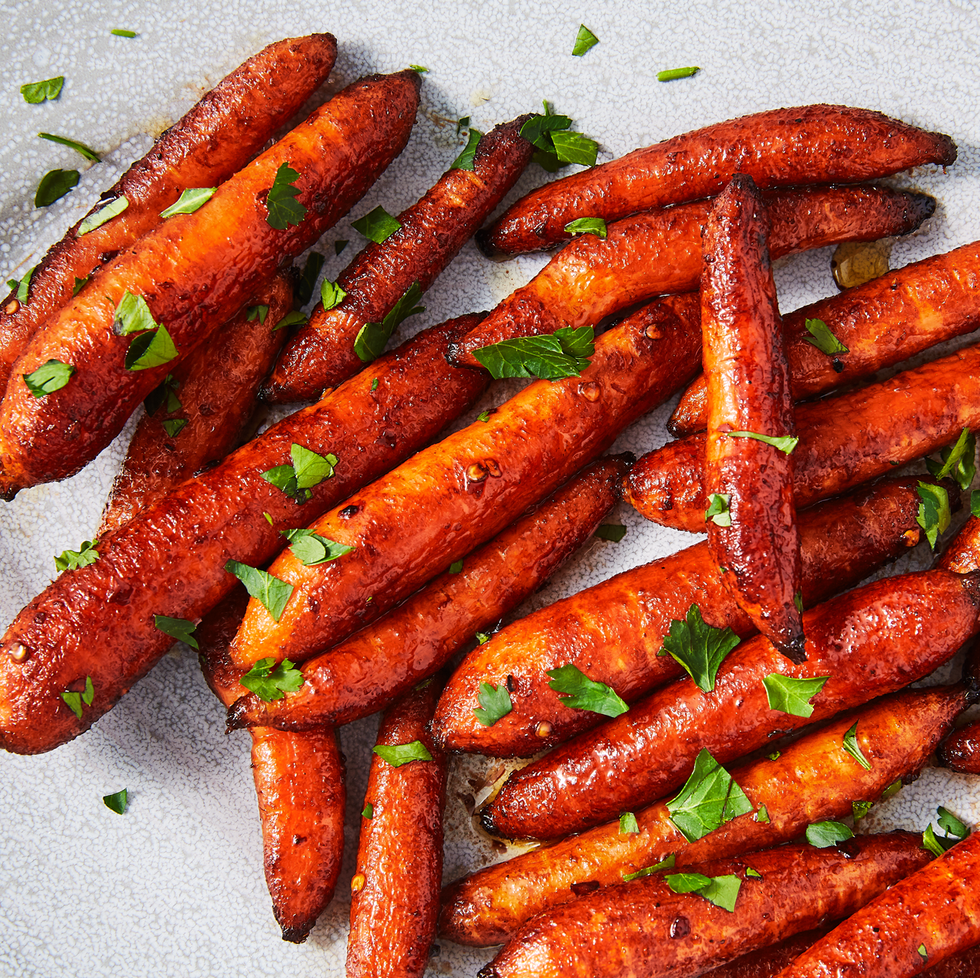

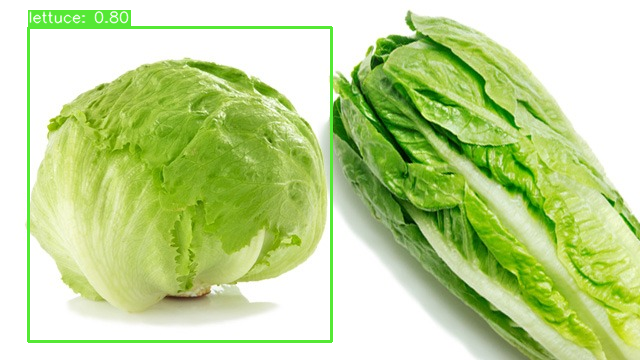

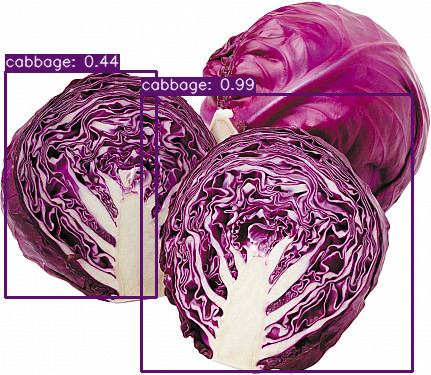

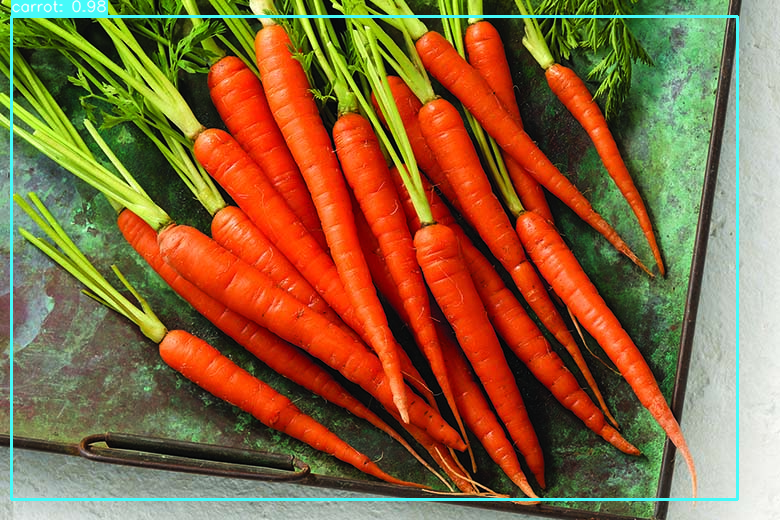

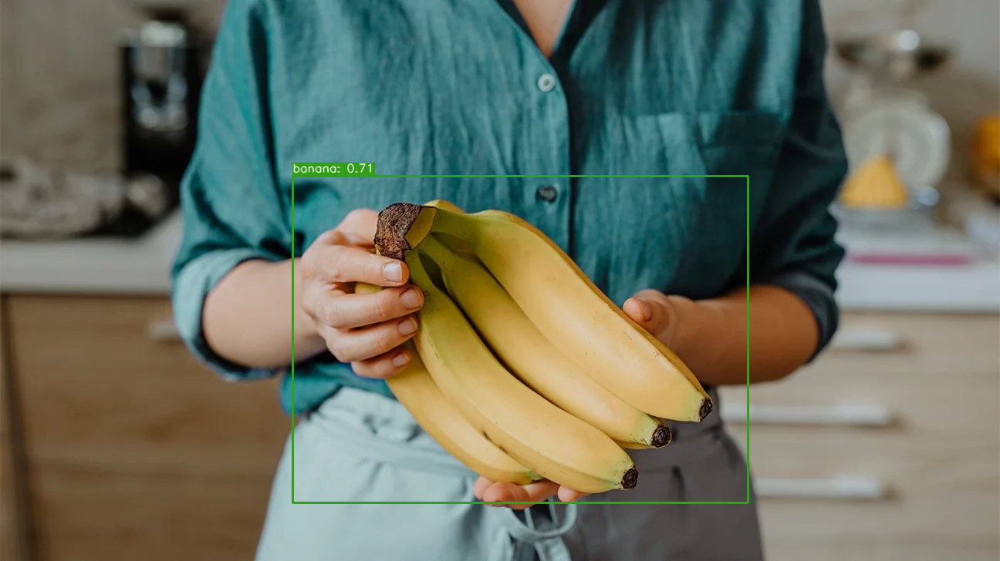

In [70]:
import cv2
import numpy as np
import glob
import random
from google.colab.patches import cv2_imshow

net = cv2.dnn.readNet('yolov3_training_last.weights', 'yolov3_testing.cfg')

# Set the image path from desktop
images_path = glob.glob(r"/content/images_test/*.jpg")

# Reiterate the classes
class_mapping = {
    'banana': 0,
    'cabbage': 1,
    'carrot': 2,
    'lettuce': 3,
    'onion': 4,
    'orange': 5,
    'potato': 6,
    'spinach': 7,
    'strawberry': 8,
    'tomato': 9
}

# Create a list of classes in the same order as class_mapping
classes = list(class_mapping.keys())

layer_names = net.getLayerNames()
output_layers = [layer_names[i - 1] for i in net.getUnconnectedOutLayers()]
colors = np.random.uniform(0, 255, size=(len(classes), 3))

# loop through all the images
for img_path in images_path:
    # Loading image
    img = cv2.imread(img_path)
    height, width, channels = img.shape

    # Detecting objects
    blob = cv2.dnn.blobFromImage(img, 0.00392, (416, 416), (0, 0, 0), True, crop=False)

    net.setInput(blob)
    outs = net.forward(output_layers)

    # Showing informations on the screen
    class_ids = []
    confidences = []
    boxes = []
    for out in outs:
        for detection in out:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            if confidence > 0.3:
                center_x = int(detection[0] * width)
                center_y = int(detection[1] * height)
                w = int(detection[2] * width) if detection[2] * width <= width else width
                h = int(detection[3] * height) if detection[3] * height <= height else height

                x = int(center_x - w / 2)
                y = int(center_y - h / 2)
                boxes.append([x, y, w, h])
                confidences.append(float(confidence))
                class_ids.append(class_id)

    indexes = cv2.dnn.NMSBoxes(boxes, confidences, 0.4, 0.4)

    # Loop through detected objects and draw bounding boxes
    for i in range(len(boxes)):
        if i in indexes:
            x, y, w, h = boxes[i]
            class_id = class_ids[i]
            label = classes[class_id]

            # Draw bounding box
            color = colors[class_id]
            cv2.rectangle(img, (x, y), (x + w, y + h), color, 2)

            # Draw label and confidence score
            confidence = confidences[i]
            text = f"{label}: {confidence:.2f}"
            text_width, text_height = cv2.getTextSize(text, cv2.FONT_HERSHEY_SIMPLEX, 0.5, 1)[0]
            cv2.rectangle(img, (x, y - text_height - 5), (x + text_width, y), color, -1)
            cv2.putText(img, text, (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 1, cv2.LINE_AA)

    # Display the image with bounding boxes and confidence scores
    cv2_imshow(img)
    cv2.waitKey(0)
    cv2.destroyAllWindows()

Despite the model not being able to recognize the roasted carrot. I am quite satisfied with it's ability to detect the other images well.

I will try the model again with a single picture I downloaded manually from google that has both banana and lettuce.

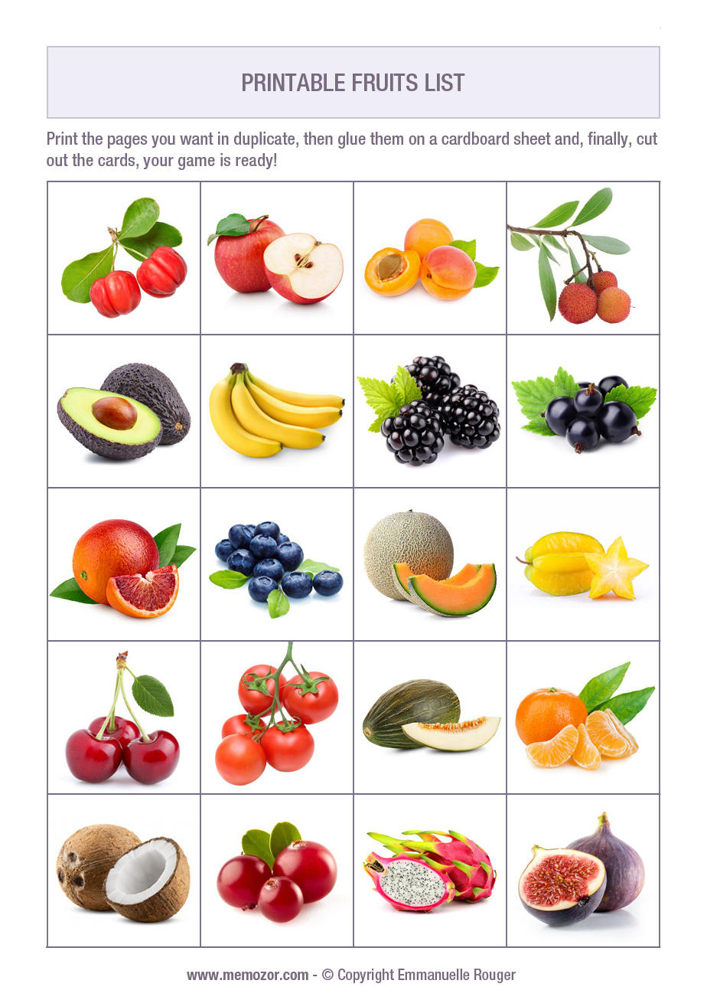

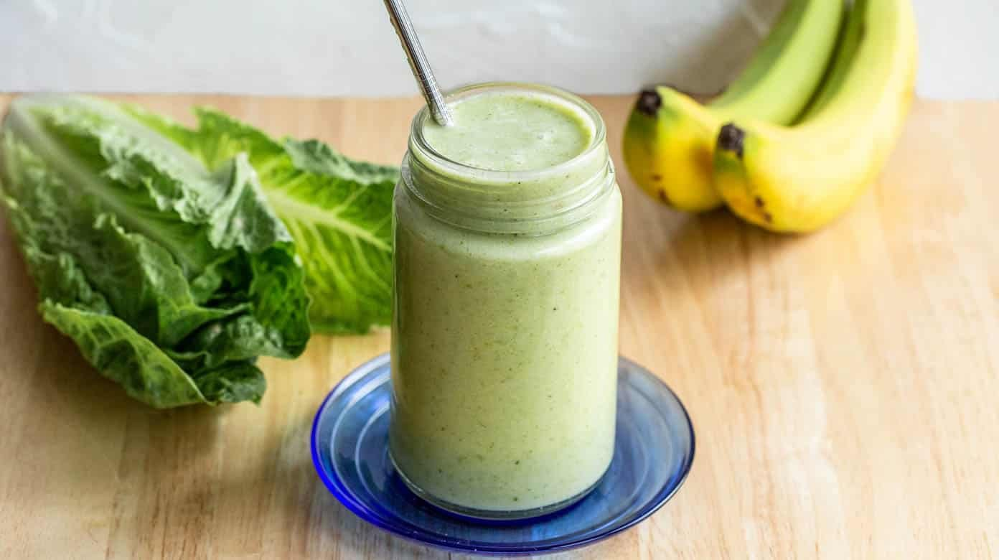

In [74]:
import cv2
import numpy as np
import glob
import random
from google.colab.patches import cv2_imshow

net = cv2.dnn.readNet('yolov3_training_last.weights', 'yolov3_testing.cfg')

# Set the image path from desktop
images_path = glob.glob(r"/content/mix/*.jpeg")

# Reiterate the classes
class_mapping = {
    'banana': 0,
    'cabbage': 1,
    'carrot': 2,
    'lettuce': 3,
    'onion': 4,
    'orange': 5,
    'potato': 6,
    'spinach': 7,
    'strawberry': 8,
    'tomato': 9
}

# Create a list of classes in the same order as class_mapping
classes = list(class_mapping.keys())

layer_names = net.getLayerNames()
output_layers = [layer_names[i - 1] for i in net.getUnconnectedOutLayers()]
colors = np.random.uniform(0, 255, size=(len(classes), 3))

# loop through all the images
for img_path in images_path:
    # Loading image
    img = cv2.imread(img_path)
    height, width, channels = img.shape

    # Detecting objects
    blob = cv2.dnn.blobFromImage(img, 0.00392, (416, 416), (0, 0, 0), True, crop=False)

    net.setInput(blob)
    outs = net.forward(output_layers)

    # Showing informations on the screen
    class_ids = []
    confidences = []
    boxes = []
    for out in outs:
        for detection in out:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            if confidence > 0.3:
                center_x = int(detection[0] * width)
                center_y = int(detection[1] * height)
                w = int(detection[2] * width) if detection[2] * width <= width else width
                h = int(detection[3] * height) if detection[3] * height <= height else height

                x = int(center_x - w / 2)
                y = int(center_y - h / 2)
                boxes.append([x, y, w, h])
                confidences.append(float(confidence))
                class_ids.append(class_id)

    indexes = cv2.dnn.NMSBoxes(boxes, confidences, 0.4, 0.4)

    # Loop through detected objects and draw bounding boxes
    for i in range(len(boxes)):
        if i in indexes:
            x, y, w, h = boxes[i]
            class_id = class_ids[i]
            label = classes[class_id]

            # Draw bounding box
            color = colors[class_id]
            cv2.rectangle(img, (x, y), (x + w, y + h), color, 2)

            # Draw label and confidence score
            confidence = confidences[i]
            text = f"{label}: {confidence:.2f}"
            text_width, text_height = cv2.getTextSize(text, cv2.FONT_HERSHEY_SIMPLEX, 0.5, 1)[0]
            cv2.rectangle(img, (x, y - text_height - 5), (x + text_width, y), color, -1)
            cv2.putText(img, text, (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 1, cv2.LINE_AA)

    # Display the image with bounding boxes and confidence scores
    cv2_imshow(img)
    cv2.waitKey(0)
    cv2.destroyAllWindows()

The result is quite dissapointing as the images were unable to be detected at all. I will try with a lower confidence score and NMS threshold.

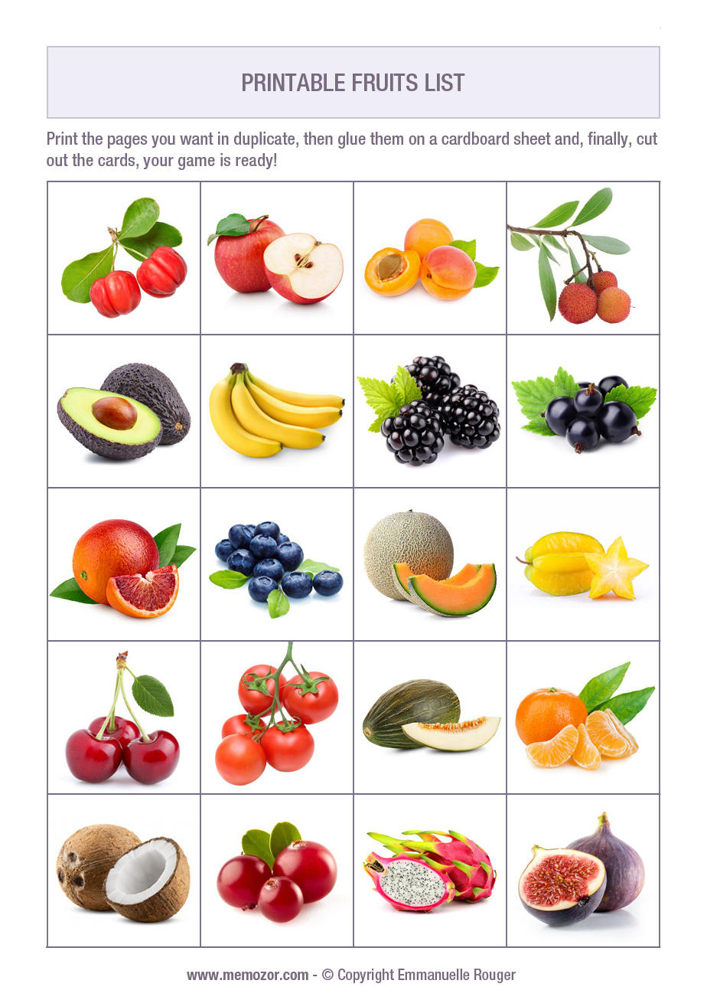

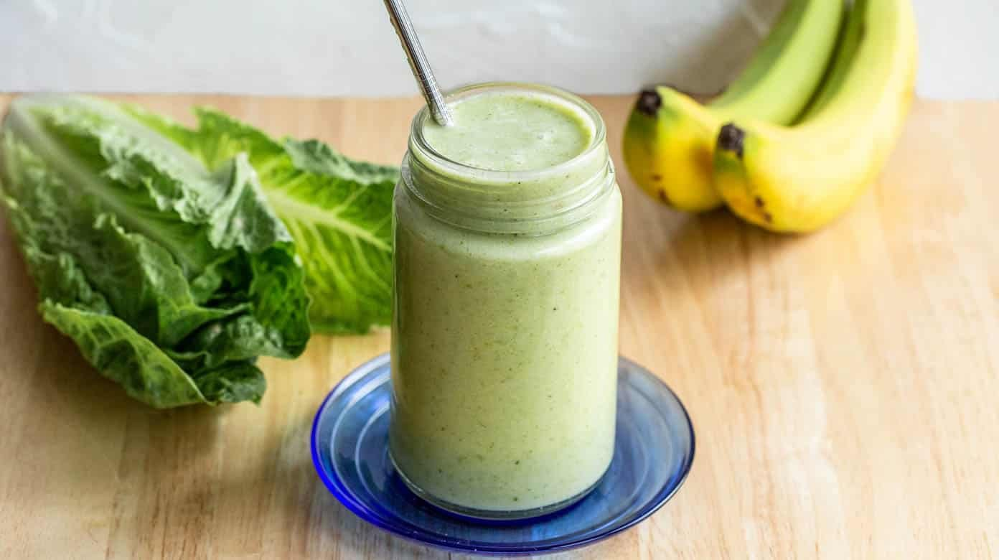

In [75]:
import cv2
import numpy as np
import glob
import random
from google.colab.patches import cv2_imshow

net = cv2.dnn.readNet('yolov3_training_last.weights', 'yolov3_testing.cfg')

# Set the image path from desktop
images_path = glob.glob(r"/content/mix/*.jpeg")

# Reiterate the classes
class_mapping = {
    'banana': 0,
    'cabbage': 1,
    'carrot': 2,
    'lettuce': 3,
    'onion': 4,
    'orange': 5,
    'potato': 6,
    'spinach': 7,
    'strawberry': 8,
    'tomato': 9
}

# Create a list of classes in the same order as class_mapping
classes = list(class_mapping.keys())

layer_names = net.getLayerNames()
output_layers = [layer_names[i - 1] for i in net.getUnconnectedOutLayers()]
colors = np.random.uniform(0, 255, size=(len(classes), 3))

# loop through all the images
for img_path in images_path:
    # Loading image
    img = cv2.imread(img_path)
    height, width, channels = img.shape

    # Detecting objects
    blob = cv2.dnn.blobFromImage(img, 0.00392, (416, 416), (0, 0, 0), True, crop=False)

    net.setInput(blob)
    outs = net.forward(output_layers)

    # Showing informations on the screen
    class_ids = []
    confidences = []
    boxes = []
    for out in outs:
        for detection in out:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            if confidence > 0.3:
                center_x = int(detection[0] * width)
                center_y = int(detection[1] * height)
                w = int(detection[2] * width) if detection[2] * width <= width else width
                h = int(detection[3] * height) if detection[3] * height <= height else height

                x = int(center_x - w / 2)
                y = int(center_y - h / 2)
                boxes.append([x, y, w, h])
                confidences.append(float(confidence))
                class_ids.append(class_id)

    indexes = cv2.dnn.NMSBoxes(boxes, confidences, 0.3, 0.3)

    # Loop through detected objects and draw bounding boxes
    for i in range(len(boxes)):
        if i in indexes:
            x, y, w, h = boxes[i]
            class_id = class_ids[i]
            label = classes[class_id]

            # Draw bounding box
            color = colors[class_id]
            cv2.rectangle(img, (x, y), (x + w, y + h), color, 2)

            # Draw label and confidence score
            confidence = confidences[i]
            text = f"{label}: {confidence:.2f}"
            text_width, text_height = cv2.getTextSize(text, cv2.FONT_HERSHEY_SIMPLEX, 0.5, 1)[0]
            cv2.rectangle(img, (x, y - text_height - 5), (x + text_width, y), color, -1)
            cv2.putText(img, text, (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 1, cv2.LINE_AA)

    # Display the image with bounding boxes and confidence scores
    cv2_imshow(img)
    cv2.waitKey(0)
    cv2.destroyAllWindows()

Despite the lowered thresholds, the model was still unable to detect the images even though it should have been able to. I suspect that this is because all the trainings are done on single image where one image only consists of one object. Thus, it was unable to detect.

With that in mind, I suspect that the flyer model will not be able to do well. However we will first try with our standard hyperparameter of 0.4 for both thresholds.

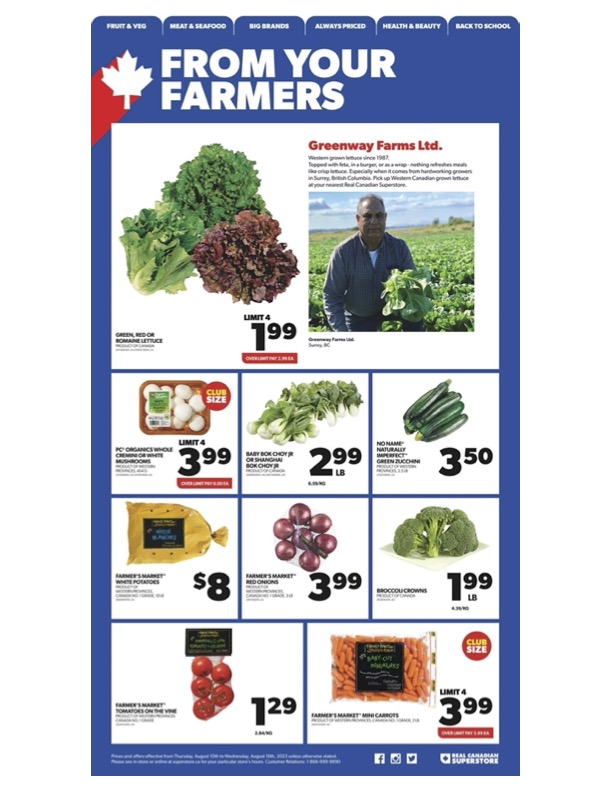

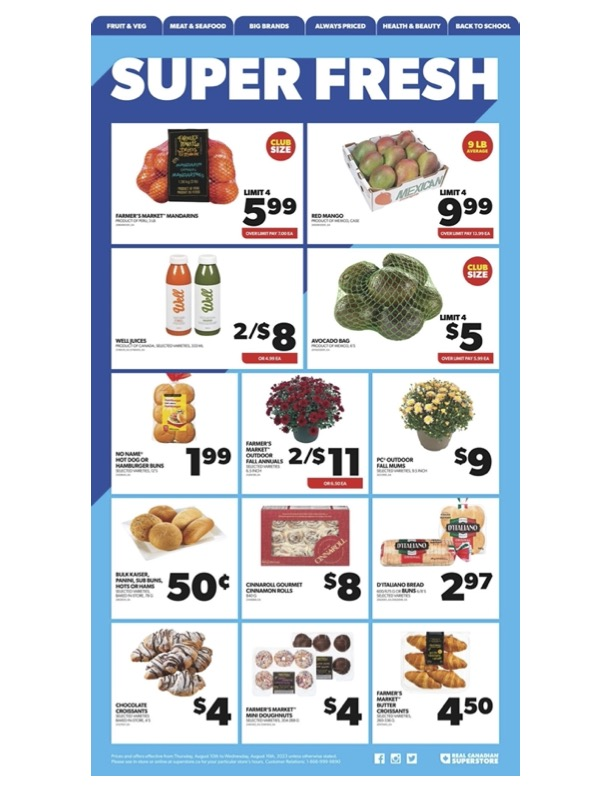

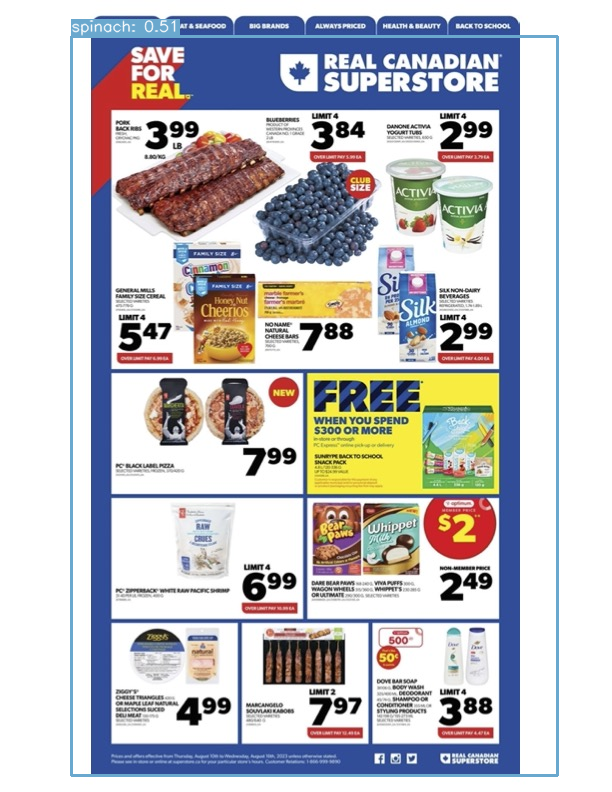

In [67]:
import cv2
import numpy as np
import glob
import random
from google.colab.patches import cv2_imshow

net = cv2.dnn.readNet('yolov3_training_last.weights', 'yolov3_testing.cfg')

# Set the image path from desktop
images_path = glob.glob(r"/content/testing_flyers/*.jpg")

# Reiterate the classes
class_mapping = {
    'banana': 0,
    'cabbage': 1,
    'carrot': 2,
    'lettuce': 3,
    'onion': 4,
    'orange': 5,
    'potato': 6,
    'spinach': 7,
    'strawberry': 8,
    'tomato': 9
}

# Create a list of classes in the same order as class_mapping
classes = list(class_mapping.keys())

layer_names = net.getLayerNames()
output_layers = [layer_names[i - 1] for i in net.getUnconnectedOutLayers()]
colors = np.random.uniform(0, 255, size=(len(classes), 3))

# loop through all the images
for img_path in images_path:
    # Loading image
    img = cv2.imread(img_path)
    height, width, channels = img.shape

    # Detecting objects
    blob = cv2.dnn.blobFromImage(img, 0.00392, (416, 416), (0, 0, 0), True, crop=False)

    net.setInput(blob)
    outs = net.forward(output_layers)

    # Showing informations on the screen
    class_ids = []
    confidences = []
    boxes = []
    for out in outs:
        for detection in out:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            if confidence > 0.3:
                center_x = int(detection[0] * width)
                center_y = int(detection[1] * height)
                w = int(detection[2] * width) if detection[2] * width <= width else width
                h = int(detection[3] * height) if detection[3] * height <= height else height

                x = int(center_x - w / 2)
                y = int(center_y - h / 2)
                boxes.append([x, y, w, h])
                confidences.append(float(confidence))
                class_ids.append(class_id)

    indexes = cv2.dnn.NMSBoxes(boxes, confidences, 0.4, 0.4)

    # Loop through detected objects and draw bounding boxes
    for i in range(len(boxes)):
        if i in indexes:
            x, y, w, h = boxes[i]
            class_id = class_ids[i]
            label = classes[class_id]

            # Draw bounding box
            color = colors[class_id]
            cv2.rectangle(img, (x, y), (x + w, y + h), color, 2)

            # Draw label and confidence score
            confidence = confidences[i]
            text = f"{label}: {confidence:.2f}"
            text_width, text_height = cv2.getTextSize(text, cv2.FONT_HERSHEY_SIMPLEX, 0.5, 1)[0]
            cv2.rectangle(img, (x, y - text_height - 5), (x + text_width, y), color, -1)
            cv2.putText(img, text, (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 1, cv2.LINE_AA)

    # Display the image with bounding boxes and confidence scores
    cv2_imshow(img)
    cv2.waitKey(0)
    cv2.destroyAllWindows()

It seems that the model mistakenly predicted a spinach in the last page of the flyer which did not exist. Furthermore, the confidence level of the spinach is above 0.51.

This indicates that the model does not function well.

Next we will also retry and run the model but with a lower confidence threshold of 0.3 to see if there are other items detected aside of spinach.

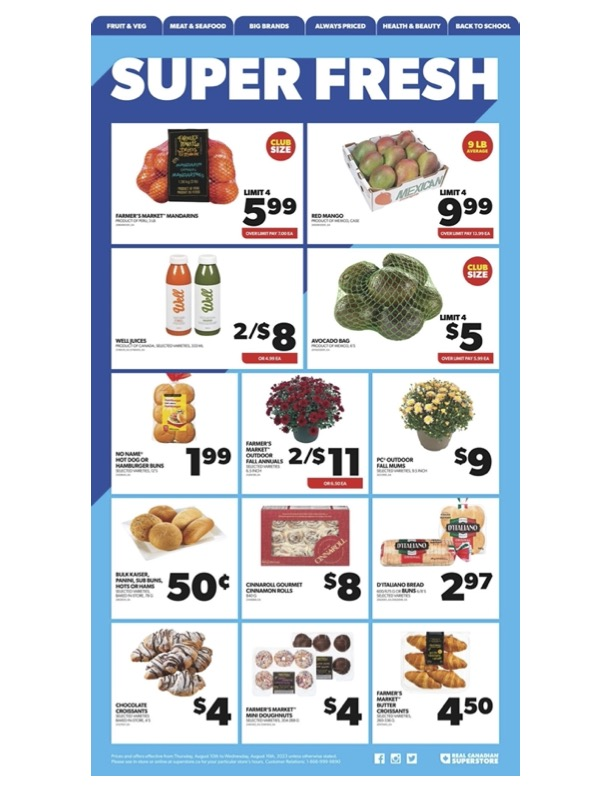

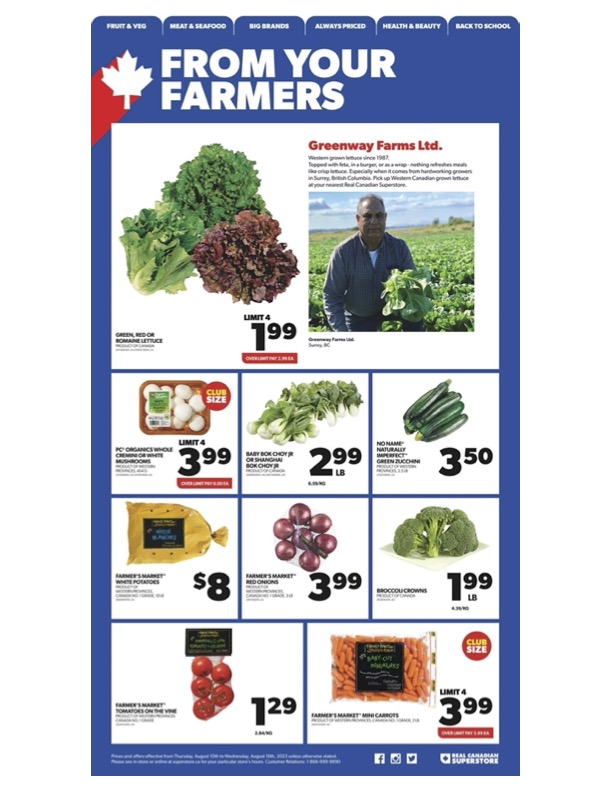

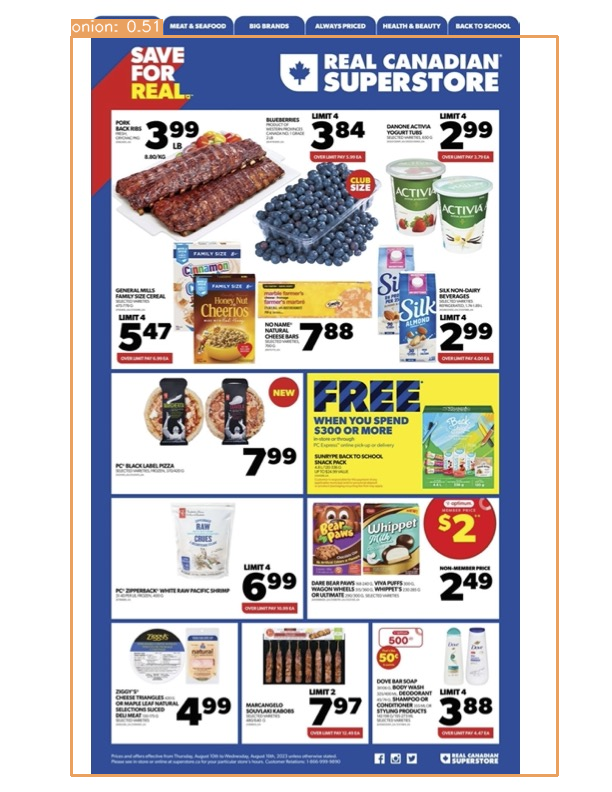

Average confidence for class banana: 0.00
Average confidence for class cabbage: 0.00
Average confidence for class carrot: 0.00
Average confidence for class lettuce: 0.00
Average confidence for class onion: 0.51
Average confidence for class orange: 0.00
Average confidence for class potato: 0.00
Average confidence for class spinach: 0.00
Average confidence for class strawberry: 0.00
Average confidence for class tomato: 0.00


In [68]:
class_confidences = {class_name: [] for class_name in classes}

classes =['carrot', 'cabbage', 'tomato', 'spinach', 'banana', 'orange', 'lettuce', 'onion', 'strawberry', 'potato']

layer_names = net.getLayerNames()
output_layers = [layer_names[i - 1] for i in net.getUnconnectedOutLayers()]
colors = np.random.uniform(0, 255, size=(len(classes), 3))

# Insert here the path of your images
random.shuffle(images_path)
# loop through all the images
for img_path in images_path:
    # Loading image
    img = cv2.imread(img_path)
    height, width, channels = img.shape

    # Detecting objects
    blob = cv2.dnn.blobFromImage(img, 0.00392, (416, 416), (0, 0, 0), True, crop=False)

    net.setInput(blob)
    outs = net.forward(output_layers)

    # Showing informations on the screen
    class_ids = []
    confidences = []
    boxes = []
    for out in outs:
        for detection in out:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            if confidence > 0.3:
                center_x = int(detection[0] * width)
                center_y = int(detection[1] * height)
                w = int(detection[2] * width) if detection[2] * width <= width else width
                h = int(detection[3] * height) if detection[3] * height <= height else height

                x = int(center_x - w / 2)
                y = int(center_y - h / 2)
                boxes.append([x, y, w, h])
                confidences.append(float(confidence))
                class_ids.append(class_id)

    indexes = cv2.dnn.NMSBoxes(boxes, confidences, 0.3, 0.4)
    font = cv2.FONT_HERSHEY_PLAIN
    for i in range(len(boxes)):
        if i in indexes:
            x, y, w, h = boxes[i]
            label = str(classes[class_ids[i]])
            confidence = confidences[i]
            color = colors[class_ids[i]]

            # Draw bounding box
            cv2.rectangle(img, (x, y), (x + w, y + h), color, 2)

            # Draw label and confidence score
            text = f"{label}: {confidence:.2f}"
            text_width, text_height = cv2.getTextSize(text, cv2.FONT_HERSHEY_SIMPLEX, 0.5, 1)[0]
            cv2.rectangle(img, (x, y - text_height - 5), (x + text_width, y), color, -1)
            cv2.putText(img, text, (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 1, cv2.LINE_AA)
            class_confidences[label].append(confidence)

    # Display the image with bounding boxes and confidence scores
    cv2_imshow(img)
    cv2.waitKey(0)
    cv2.destroyAllWindows()
cv2.destroyAllWindows()

for class_name, confidences in class_confidences.items():
    avg_confidence = sum(confidences) / len(confidences) if len(confidences) > 0 else 0.0
    print(f"Average confidence for class {class_name}: {avg_confidence:.2f}")

Curiously, the model also mistakenly detected onion on the third flyer which did not contain onion. In fact, the second flyer actually contained onion but was undetected.

In addition we can see that when the confidence threshold was higher on the previous cell, the model predicted spinach on the third flyer with the same confidence score as this current model (0.51). This further proves that the model is inaccurate.

#### **Probability Score**

In each of the bounding box, we can see that there are numbers which is the confidence scores. Each confidence score represents the probability scores as printed as well.

The confidence score is calculated based on whether the model perceive that it is able to calculate the prediction correctly. This confidence score is taken from the YOLOV3 model detection process. However, it does not represent the actual accuracy of the prediction towards the ground truth.

The confidence score is essentially a product of objectness score and class score or in other words it can be calculated as

C =  Pr(object) * IoU

The IoU is the area of intersection / all of the areas or (ground truth + prediction)

Both models shows a similar probability or confidence score of 0.51. However those predictions are entirely wrong.

### **Further Discussions**

##### Share insights gained from the project, challenges faced, and potential enhancements to the object detection model.


From this project I learned the implentation of object detection and the usage of darknet as the base architecture for yolo. I was never familiar with the term before and it also made me understood more about the concept of image detection.

However, there were many challenges I faced in this project as evident by the unfavourable outcome displayed.

For once, when I downloaded the image there were not sufficient onion pictures. Therefore, I had to supplement the lack of onion with other vegetables. This creates an imbalance which I believe may have contributed to the model imbalance.

Second, I initially thought that 10 images per class would at least give me some predictions regardless of the low accuracy. However, despite the model working relatively well for single image detection it did not work well for the flyer.

Furthermore, I also found issues with the training as it takes a lot of time and exhausted my colab pro GPU. Also, I was not aware that the xml.txt file would be a hindrance to the label. I ran the training twice before I realised the issue.

Fourth, in relation to the result above, I am concerned that the model was not able to 'digest' the flyer image well and thus it made awful predictions. I reached this conclusion because when I tested the model on the image tests they worked fairly well.

Last but not least as I was not well familiar with the libraries. I believe this was a steep learning curve for me but rewarding at the same time. It took me nearly a day to find ways to calculate the mAP without using pytorch or the other complicated suggestions online.

For recommnedations, I believe if trained in a larger number of image per class then the model should have better accuracy. Also, the flyer fed into the model should also have a better qualiy for better prediction.

To supplement this exam, I will also be conducting the same test on the pretrained yolov4 model to see whether a pretrained model could detect the flyer well.